In [1]:
from pycaret import datasets, classification as clf

In [2]:
credit = datasets.get_data("credit", profile=True)

Summarize dataset:   0%|          | 0/37 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [3]:
credit.shape

(24000, 24)

In [5]:
credit_known = credit.sample(frac=0.95, random_state=786)
credit_unknown = credit.drop(credit_known.index)
credit_known.reset_index(inplace=True, drop=True)
credit_unknown.reset_index(inplace=True, drop=True)

In [6]:
credit_known.shape

(22800, 24)

In [7]:
credit_unknown.shape

(1200, 24)

In [8]:
credit_pycaret = clf.setup(
    data=credit_known,
    target="default",
    session_id=123,
    normalize=True,
    transformation=True,
    ignore_low_variance=True,
    remove_multicollinearity=True,
    multicollinearity_threshold=0.95,
    bin_numeric_features=["LIMIT_BAL", "AGE"],
    group_features=[
        [f"BILL_AMT{i}" for i in range(1, 7)],
        [f"PAY_AMT{i}" for i in range(1, 7)],
    ],
    log_experiment=True,
    experiment_name="credit1",
)

,Description,Value
0,session_id,123
1,Target,default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


In [9]:
top3 = clf.compare_models(n_select=3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8252,0.0000,0.3594,0.6937,0.4732,0.3810,0.4107,0.0370
lda,Linear Discriminant Analysis,0.8242,0.7746,0.3769,0.6757,0.4837,0.3880,0.4121,0.1470
gbc,Gradient Boosting Classifier,0.8240,0.7771,0.3591,0.6865,0.4714,0.3781,0.4068,1.8040
ada,Ada Boost Classifier,0.8222,0.7734,0.3379,0.6910,0.4536,0.3621,0.3953,0.4120
lightgbm,Light Gradient Boosting Machine,0.8208,0.7681,0.3603,0.6670,0.4676,0.3713,0.3969,0.9510
catboost,CatBoost Classifier,0.8204,0.7743,0.3591,0.6649,0.4662,0.3696,0.3951,2.7450
rf,Random Forest Classifier,0.8180,0.7573,0.3494,0.6585,0.4562,0.3591,0.3853,0.5770
et,Extra Trees Classifier,0.8162,0.7502,0.3683,0.6380,0.4668,0.3654,0.3856,0.4130
xgboost,Extreme Gradient Boosting,0.8138,0.7544,0.3568,0.6313,0.4557,0.3537,0.3748,2.8650
lr,Logistic Regression,0.7878,0.6995,0.1032,0.5893,0.1732,0.1164,0.1761,0.3900


In [10]:
top3

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                 max_iter=None, normalize=False, random_state=123, solver='auto',
                 tol=0.001),
 LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                            solver='svd', store_covariance=False, tol=0.0001),
 GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='deviance', max_depth=3,
                            max_features=None, max_leaf_nodes=None,
                            min_impurity_decrease=0.0, min_impurity_split=None,
                            min_samples_leaf=1, min_samples_split=2,
                            min_weight_fraction_leaf=0.0, n_estimators=100,
                            n_iter_no_change=None, presort='deprecated',
                            random_state=123, subsample=1.0, tol=0.0001,
                            validation_fraction=0.1, verbo

In [11]:
dt = clf.create_model("dt", fold=5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7284,0.6133,0.4026,0.3844,0.3933,0.2184,0.2185
1,0.7321,0.6182,0.4112,0.3926,0.4017,0.2292,0.2293
2,0.7303,0.6226,0.4269,0.3926,0.4091,0.2347,0.2351
3,0.7356,0.6176,0.4069,0.3978,0.4023,0.2325,0.2326
4,0.7364,0.6151,0.4003,0.3974,0.3989,0.2301,0.2301
Mean,0.7326,0.6173,0.4096,0.3930,0.4010,0.2290,0.2291
SD,0.0031,0.0032,0.0094,0.0048,0.0051,0.0056,0.0057


In [12]:
rf = clf.create_model("rf", round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.81,0.76,0.32,0.61,0.42,0.32,0.34
1,0.82,0.76,0.38,0.66,0.48,0.38,0.41
2,0.82,0.77,0.32,0.67,0.43,0.34,0.38
3,0.82,0.76,0.36,0.65,0.47,0.37,0.39
4,0.82,0.76,0.35,0.66,0.46,0.36,0.39
5,0.83,0.77,0.37,0.69,0.48,0.39,0.41
6,0.82,0.76,0.36,0.66,0.46,0.37,0.39
7,0.82,0.74,0.33,0.69,0.45,0.36,0.39
8,0.81,0.74,0.35,0.62,0.44,0.34,0.36
9,0.82,0.76,0.36,0.65,0.46,0.37,0.39


In [13]:
tuned_rf = clf.tune_model(rf, optimize="AUC")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7513,0.7702,0.6504,0.4522,0.5335,0.3713,0.3827
1,0.7575,0.7687,0.6562,0.4617,0.5420,0.3838,0.3948
2,0.7538,0.7701,0.6447,0.4555,0.5338,0.3732,0.3836
3,0.7393,0.7826,0.6762,0.4378,0.5315,0.3622,0.3786
4,0.7525,0.7948,0.6648,0.4549,0.5402,0.3789,0.3916
5,0.7575,0.7813,0.6590,0.4618,0.5431,0.3849,0.3962
6,0.7262,0.7670,0.6705,0.4209,0.5171,0.3397,0.3577
7,0.7513,0.7500,0.5989,0.4485,0.5129,0.3505,0.3571
8,0.7318,0.7432,0.6246,0.4233,0.5046,0.3300,0.3417
9,0.7254,0.7600,0.6236,0.4141,0.4977,0.3192,0.3318


In [14]:
clf.plot_model(tuned_rf, plot="parameter")

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced_subsample
criterion,gini
max_depth,4
max_features,sqrt
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.0005
min_impurity_split,None


In [15]:
dts = clf.create_model("dt")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7356,0.6225,0.4183,0.4000,0.4090,0.2388,0.2389
1,0.7393,0.6346,0.4413,0.4107,0.4254,0.2571,0.2574
2,0.7343,0.6120,0.3926,0.3926,0.3926,0.2225,0.2225
3,0.7268,0.6175,0.4212,0.3858,0.4027,0.2261,0.2265
4,0.7393,0.6261,0.4183,0.4067,0.4124,0.2450,0.2450
5,0.7256,0.5987,0.3754,0.3732,0.3743,0.1985,0.1985
6,0.7312,0.6155,0.4126,0.3913,0.4017,0.2285,0.2286
7,0.7431,0.6135,0.3840,0.4073,0.3953,0.2324,0.2325
8,0.7318,0.6204,0.4212,0.3941,0.4072,0.2342,0.2344
9,0.7354,0.6260,0.4339,0.4016,0.4171,0.2463,0.2466


In [18]:
bagged_dt = clf.ensemble_model(dts)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8064,0.7300,0.3238,0.6075,0.4224,0.3189,0.3417
1,0.8152,0.7289,0.3725,0.6311,0.4685,0.3655,0.3841
2,0.8102,0.7341,0.3209,0.6292,0.4250,0.3254,0.3519
3,0.8095,0.7394,0.3266,0.6230,0.4286,0.3274,0.3520
4,0.8051,0.7262,0.3152,0.6044,0.4143,0.3110,0.3348
5,0.8114,0.7368,0.3524,0.6212,0.4497,0.3462,0.3665
6,0.7964,0.7279,0.3095,0.5625,0.3993,0.2889,0.3076
7,0.8145,0.7235,0.3181,0.6568,0.4286,0.3335,0.3648
8,0.8008,0.7073,0.3095,0.5838,0.4045,0.2982,0.3198
9,0.8144,0.7223,0.3764,0.6238,0.4695,0.3653,0.3824


In [19]:
boosted_dt = clf.ensemble_model(dts, method="Boosting")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7563,0.6397,0.3610,0.4315,0.3931,0.2422,0.2437
1,0.7701,0.6684,0.3668,0.4672,0.4109,0.2706,0.2737
2,0.7832,0.6625,0.3123,0.5070,0.3865,0.2638,0.2752
3,0.7694,0.6478,0.2894,0.4570,0.3544,0.2226,0.2312
4,0.7788,0.7193,0.4241,0.4933,0.4561,0.3183,0.3197
5,0.7569,0.6793,0.4011,0.4389,0.4192,0.2658,0.2663
6,0.7732,0.6685,0.3696,0.4760,0.4161,0.2781,0.2816
7,0.7826,0.6933,0.3152,0.5046,0.3880,0.2643,0.2751
8,0.7638,0.6917,0.3524,0.4489,0.3949,0.2507,0.2536
9,0.7925,0.6843,0.3448,0.5381,0.4203,0.3012,0.3123


In [20]:
lightgbm = clf.create_model("lightgbm", verbose=False)
dtb = clf.create_model("dt", verbose=False)
lr = clf.create_model("lr", verbose=False)

In [21]:
blend_soft = clf.blend_models([lightgbm, dtb, lr], method="soft")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7776,0.7415,0.3868,0.4891,0.4320,0.2960,0.2992
1,0.8045,0.7477,0.3668,0.5845,0.4507,0.3393,0.3529
2,0.7769,0.7412,0.3610,0.4865,0.4145,0.2804,0.2852
3,0.7926,0.7533,0.3496,0.5398,0.4243,0.3049,0.3156
4,0.7976,0.7724,0.3381,0.5619,0.4222,0.3086,0.3232
5,0.7675,0.7464,0.3438,0.4580,0.3928,0.2526,0.2566
6,0.7726,0.7364,0.3754,0.4746,0.4192,0.2802,0.2832
7,0.7982,0.7397,0.3066,0.5722,0.3993,0.2911,0.3116
8,0.7945,0.7368,0.3381,0.5488,0.4184,0.3021,0.3152
9,0.7975,0.7376,0.3649,0.5546,0.4402,0.3230,0.3335


In [23]:
blend_hard = clf.blend_models([lightgbm, dtb, lr], method="hard")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8139,0.0000,0.2980,0.6667,0.4119,0.3200,0.3567
1,0.8233,0.0000,0.3181,0.7161,0.4405,0.3535,0.3947
2,0.8133,0.0000,0.2951,0.6645,0.4087,0.3168,0.3538
3,0.8120,0.0000,0.2808,0.6667,0.3952,0.3051,0.3452
4,0.8177,0.0000,0.2865,0.7042,0.4073,0.3215,0.3671
5,0.8133,0.0000,0.2837,0.6735,0.3992,0.3097,0.3505
6,0.8158,0.0000,0.3152,0.6667,0.4280,0.3346,0.3680
7,0.8076,0.0000,0.2350,0.6721,0.3482,0.2649,0.3156
8,0.8139,0.0000,0.2693,0.6912,0.3876,0.3020,0.3489
9,0.8132,0.0000,0.2960,0.6603,0.4087,0.3164,0.3524


In [24]:
blend_top3 = clf.blend_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8189,0.0000,0.3582,0.6579,0.4638,0.3661,0.3906
1,0.8315,0.0000,0.3897,0.7083,0.5028,0.4114,0.4381
2,0.8214,0.0000,0.3410,0.6839,0.4551,0.3623,0.3937
3,0.8296,0.0000,0.3754,0.7081,0.4906,0.3997,0.4288
4,0.8221,0.0000,0.3582,0.6757,0.4682,0.3732,0.4003
5,0.8321,0.0000,0.4011,0.7035,0.5109,0.4186,0.4427
6,0.8221,0.0000,0.3610,0.6738,0.4701,0.3747,0.4011
7,0.8277,0.0000,0.3553,0.7126,0.4742,0.3847,0.4180
8,0.8202,0.0000,0.3553,0.6667,0.4636,0.3674,0.3936
9,0.8245,0.0000,0.3793,0.6735,0.4853,0.3893,0.4126


In [25]:
stack_soft = clf.stack_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7870,0.7003,0.0802,0.5957,0.1414,0.0944,0.1589
1,0.7888,0.7038,0.0888,0.6200,0.1554,0.1064,0.1746
2,0.7857,0.6954,0.0860,0.5660,0.1493,0.0972,0.1558
3,0.7838,0.7146,0.0860,0.5357,0.1481,0.0933,0.1463
4,0.7957,0.7281,0.1117,0.7091,0.1931,0.1420,0.2241
5,0.7895,0.7056,0.0831,0.6444,0.1472,0.1024,0.1755
6,0.7926,0.7204,0.0917,0.6957,0.1620,0.1171,0.1988
7,0.7957,0.6808,0.1461,0.6456,0.2383,0.1714,0.2357
8,0.7926,0.7135,0.0946,0.6875,0.1662,0.1197,0.1997
9,0.7831,0.6893,0.1523,0.5096,0.2345,0.1491,0.1864


In [26]:
rfc = clf.create_model("rf")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8070,0.7557,0.3181,0.6133,0.4189,0.3168,0.3414
1,0.8221,0.7599,0.3754,0.6650,0.4799,0.3824,0.4052
2,0.8177,0.7652,0.3209,0.6747,0.4350,0.3422,0.3759
3,0.8189,0.7578,0.3639,0.6546,0.4678,0.3692,0.3923
4,0.8189,0.7572,0.3524,0.6613,0.4598,0.3630,0.3889
5,0.8258,0.7748,0.3668,0.6919,0.4794,0.3864,0.4145
6,0.8189,0.7593,0.3582,0.6579,0.4638,0.3661,0.3906
7,0.8221,0.7438,0.3324,0.6946,0.4496,0.3589,0.3936
8,0.8102,0.7433,0.3467,0.6173,0.4440,0.3403,0.3609
9,0.8188,0.7559,0.3592,0.6545,0.4638,0.3657,0.3896


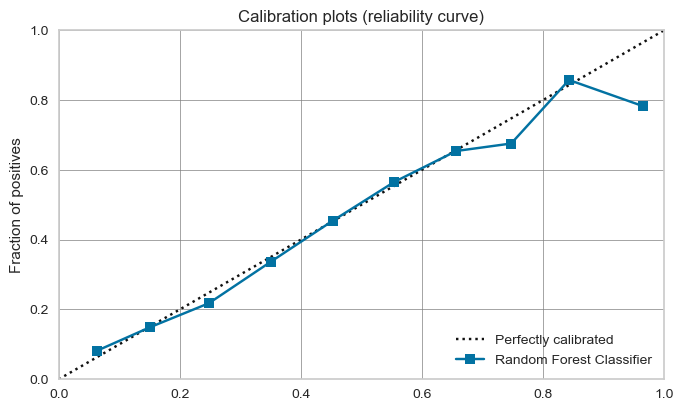

In [29]:
clf.plot_model(rfc, plot="calibration")

In [30]:
calibrated_rf = clf.calibrate_model(rfc)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8058,0.7653,0.3009,0.6140,0.4038,0.3037,0.3313
1,0.8315,0.7657,0.3725,0.7222,0.4915,0.4026,0.4343
2,0.8189,0.7693,0.3095,0.6923,0.4277,0.3383,0.3771
3,0.8258,0.7650,0.3668,0.6919,0.4794,0.3864,0.4145
4,0.8170,0.7708,0.3324,0.6629,0.4427,0.3474,0.3771
5,0.8252,0.7759,0.3610,0.6923,0.4746,0.3819,0.4111
6,0.8183,0.7689,0.3295,0.6725,0.4423,0.3486,0.3803
7,0.8271,0.7506,0.3352,0.7267,0.4588,0.3721,0.4117
8,0.8152,0.7524,0.3295,0.6534,0.4381,0.3416,0.3703
9,0.8201,0.7642,0.3420,0.6723,0.4533,0.3590,0.3885


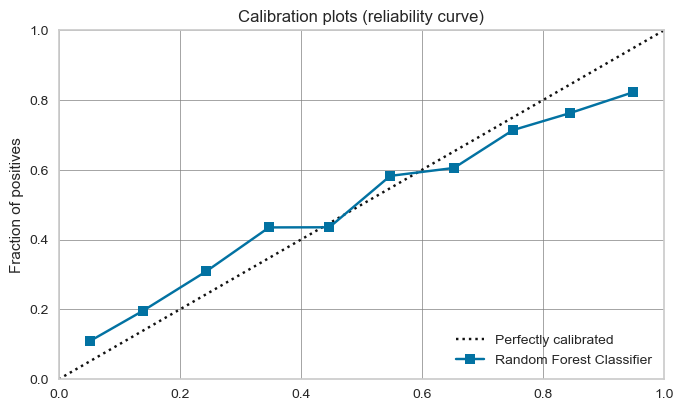

In [32]:
clf.plot_model(calibrated_rf, plot="calibration")